In [1]:
#Balanced Encoder Decoder 
#BottleNeck: 14

In [2]:
#Disable Warning
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
import warnings
warnings.filterwarnings("ignore")

In [3]:
FILE1 = 'SB-001_normalized_AM.csv'
FILE2 = 'SB-001_normalized_PM.csv'
NO_OF_COLUMNS = 24

In [4]:
#pip install tf2onnx
import tensorflow as tf
from tensorflow import keras
import seaborn as sns
import matplotlib.pyplot as plt
plt.ioff()
import cv2
import IPython
from tqdm import tqdm
import time
import os
import pickle
import pandas as pd
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")
warnings.filterwarnings('ignore', message=r'.*Consider either turning off auto-sharding.*')

In [5]:
run_summary = []

In [6]:
def generate_autoencoder_reports(encoder_dense_layers, bottle_neck, decoder_dense_layers):

    print(encoder_dense_layers, bottle_neck, decoder_dense_layers)
    # Load Data
    df_am = pd.read_csv(FILE1)
    df_pm = pd.read_csv(FILE2)
    combined_df = pd.concat([df_am, df_pm])

    columns_needed = ['y_am_pef', 'tempin', 'humidin', 'pm25in', 'co2in', 'tempdiffin', 'humidiffin', 'pm25diffin',
                      'pm10', 'pm25', 'o3', 'no2', 'co', 'so2', 'temp', 'windsd', 'humid', 'varp', 'dewpt', 'airp',
                      'seap', 'solrhr', 'solramnt', 'grdt', 'class']
    combined_df = combined_df.filter(columns_needed)
    df = combined_df.sample(frac=1, random_state=42).reset_index(drop=True)

    # Drop NaN
    df = df.dropna()

    # Minotity Split
    class_counts = df['class'].value_counts()
    minority_class = df[df['class'] == 0]
    majority_class = df[df['class'] == 1]

    # Removing class column from minority before augmentation
    X = minority_class.drop('class', axis=1)
    y = minority_class['class']

    # Saving minority as X_train
    X_train = X

    # Define the Input shape
    INPUT_SHAPE = X_train.shape[1]
    FILE_NAME = f"L{INPUT_SHAPE}_E{'_'.join(map(str, encoder_dense_layers))}_B{bottle_neck}_D{'_'.join(map(str, decoder_dense_layers))}"
    print("\n" + FILE_NAME + "\n")
    
    def build_autoencoder(input_shape, **kwargs):

        # Autoencoder model construction cod

      """
      Build an autoencoder model with the given configuration.

      Args:
          input_shape (int): The shape of the input data.
          **kwargs: Additional keyword arguments for configuring the autoencoder.

      Keyword Args:
          encoder_dense_layers (list): List of integers specifying the number of units for each dense layer in the encoder.
                                      Default: []
          bottle_neck (int): The number of units in the bottleneck layer. Default: input_shape // 2
          decoder_dense_layers (list): List of integers specifying the number of units for each dense layer in the decoder.
                                      Default: []
          decoder_activation (str): The activation function for the decoder output layer. Default: 'sigmoid'

      Returns:
          tuple: A tuple containing the autoencoder, encoder, and decoder models.

      Example:
          INPUT_SHAPE = 27
          encoder_dense_layers = [20, 18]  # Specify the number of units for each dense layer in the encoder
          bottle_neck = 16
          decoder_dense_layers = [18, 20]  # Specify the number of units for each dense layer in the decoder

          autoencoder, encoder, decoder = build_autoencoder(INPUT_SHAPE, encoder_dense_layers=encoder_dense_layers,
                                                            bottle_neck=bottle_neck, decoder_dense_layers=decoder_dense_layers)
          encoder.summary()
          decoder.summary()
          autoencoder.summary()
      """

      # Default parameter values
      encoder_dense_layers = kwargs.get('encoder_dense_layers', [])
      bottle_neck = kwargs.get('bottle_neck', input_shape // 2)
      decoder_dense_layers = kwargs.get('decoder_dense_layers', [])
      decoder_activation = kwargs.get('decoder_activation', 'sigmoid')

      # Autoencoder Model
      encoder_input = keras.Input(shape=(input_shape,), name="encoder")
      x = keras.layers.Flatten()(encoder_input)

      # Encoder Dense Layers
      for units in encoder_dense_layers:
          x = keras.layers.Dense(units, activation="relu")(x)

      encoder_output = keras.layers.Dense(bottle_neck, activation="relu")(x)
      encoder = keras.Model(encoder_input, encoder_output, name="encoder")

      # Decoder Model
      decoder_input = keras.Input(shape=(bottle_neck,), name="decoder")
      x = decoder_input

      # Decoder Dense Layers
      for units in decoder_dense_layers:
          x = keras.layers.Dense(units, activation="relu")(x)

      decoder_output = keras.layers.Dense(input_shape, activation=decoder_activation)(x)
      decoder = keras.Model(decoder_input, decoder_output, name="decoder")

      # Autoencoder Model
      autoencoder_input = keras.Input(shape=(input_shape,), name="input")
      encoded = encoder(autoencoder_input)
      decoded = decoder(encoded)
      autoencoder = keras.Model(autoencoder_input, decoded, name="autoencoder")

      return autoencoder, encoder, decoder

    autoencoder, encoder, decoder = build_autoencoder(INPUT_SHAPE, encoder_dense_layers=encoder_dense_layers,
                                                      bottle_neck=bottle_neck,
                                                      decoder_dense_layers=decoder_dense_layers)
    opt = keras.optimizers.Adam(learning_rate=0.001)
    autoencoder.compile(opt, loss="mse")

    print("Training model:", FILE_NAME)
    history = autoencoder.fit(X_train, X_train, epochs=200, batch_size=16, validation_split=0.25, verbose=0)
    print("Training Complete:")
    
    # Extract the loss values
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    # Print the last epoch's loss values
    last_epoch_loss = loss[-1]
    last_epoch_val_loss = val_loss[-1]
    print("Last epoch loss:", last_epoch_loss)
    print("Last epoch validation loss:", last_epoch_val_loss)

    # Saving history
    with open(FILE_NAME + '_history.pickle', 'wb') as file:
        pickle.dump(history.history, file)

    # Visualize losses *(MSE)
    train_loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(train_loss) + 1)
    plt.plot(epochs, train_loss, 'b', label='Training Loss')
    plt.plot(epochs, val_loss, 'r', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.savefig(FILE_NAME + 'Loss.png')
    #plt.show()

    # Generate synthetic data
    num_samples = len(X_train)
    input_data = np.random.normal(size=(num_samples, INPUT_SHAPE))
    generated_data = autoencoder.predict(input_data)
    reshaped_data = generated_data.reshape(num_samples, -1)
    df_generated = pd.DataFrame(reshaped_data, columns=X_train.columns)

    # Plot correlation matrices
    corr_matrix1 = X_train.corr()
    corr_matrix2 = df_generated.corr()

    fig, axes = plt.subplots(1, 2, figsize=(18, 10))
    sns.heatmap(corr_matrix1, annot=True, cmap='coolwarm', ax=axes[0])
    axes[0].set_title('Heatmap 1')

    sns.heatmap(corr_matrix2, annot=True, cmap='coolwarm', ax=axes[1])
    axes[1].set_title('Heatmap 2')

    plt.tight_layout()
    plt.savefig(FILE_NAME + 'HeatMaps')
    #plt.show()

    # Calculate mean and standard deviation of original and synthetic datasets
    common_columns = set(X_train.columns) & set(df_generated.columns)
    results = {}

    for column in common_columns:
        mean_df1 = X_train[column].mean()
        std_df1 = X_train[column].std()
        mean_df2 = df_generated[column].mean()
        std_df2 = df_generated[column].std()

        results[column] = {'Mean_df1': mean_df1, 'Std_df1': std_df1,
                           'Mean_df2': mean_df2, 'Std_df2': std_df2}

    comparison_df = pd.DataFrame(results)
    comparison_df.to_csv(FILE_NAME + 'mean_std.csv', index=True)

    # Plot scatter plots
    new_index = pd.RangeIndex(start=0, stop=57, step=1)
    X_train = X_train.set_index(new_index)
    common_columns = set(X_train.columns) & set(df_generated.columns)

    for column in common_columns:
        plt.scatter(X_train.index, X_train[column], color='red', label='X_train')
        plt.scatter(df_generated.index, df_generated[column], color='blue', label='df_generated')

        plt.title(f"Scatter Plot: {column}")
        plt.xlabel("Index")
        plt.ylabel(column)

        plt.legend()
        plt.savefig(FILE_NAME + "_" + column)
        #plt.show()


    # Add back the class label
    X_train['class'] = 0.0
    df_generated['class'] = 0.0
    X_train.to_csv(FILE_NAME + 'Original_minority_data.csv', index=False)
    df_generated.to_csv(FILE_NAME + 'Synthetic_minority_data.csv', index=False)

    # Generate quality report and display it
    real_data = FILE_NAME + 'Original_minority_data.csv'
    synth_data = FILE_NAME + 'Synthetic_minority_data.csv'

    # report = QualityReport(data_source=synth_data, ref_data=real_data)
    # report.run()

    # print(report.peek())
    #run_summary.append([FILE_NAME, report.peek()['raw_score'], report.peek()['grade']])
    run_summary.append([FILE_NAME, last_epoch_loss, last_epoch_val_loss])

    print("Reports Saved")
    #IPython.display.HTML(report.as_html, metadata=dict(isolated=True))
    return None

In [7]:
# Example usage
def runner(encoder_dense_layers, bottle_neck, decoder_dense_layers):
  #encoder_dense_layers = [10, 8]
  #bottle_neck = 5
  #decoder_dense_layers = [8, 10]
  #FILE_NAME = f"24_{'_'.join(map(str, encoder_dense_layers))}_{bottle_neck}_"
  FILE_NAME = f"L{NO_OF_COLUMNS}_E{'_'.join(map(str, encoder_dense_layers))}_B{bottle_neck}_D{'_'.join(map(str, decoder_dense_layers))}"   
  report = generate_autoencoder_reports(encoder_dense_layers, bottle_neck, decoder_dense_layers)
  #print(type(report))
  # Save the report object to a file
  # with open(FILE_NAME + 'quality_report.pickle', 'wb') as file:
  #     pickle.dump(report, file)

  #IPython.display.HTML(report.as_html, metadata=dict(isolated=True))

In [8]:
# here goes nothin

In [9]:
encoder_dense_layers_trial = [[10, 8], [12, 10], [14, 12], [16, 14], [18, 16], [20, 18] ,[22,20]]
decoder_dense_layers_trial = [[8, 10], [10, 12], [12, 14], [14, 16], [16, 18], [18, 20], [20,22]]
bottle_neck_trial = [14]

In [10]:
total_iterations = len(bottle_neck_trial) * len(encoder_dense_layers_trial) * len(decoder_dense_layers_trial)
print("Total Model in Pipeline:",total_iterations)

# Print total models
for bn in bottle_neck_trial:
  for enc_layers in encoder_dense_layers_trial:
      for dec_layers in decoder_dense_layers_trial:
          print(enc_layers, bn, dec_layers)

Total Model in Pipeline: 49
[10, 8] 14 [8, 10]
[10, 8] 14 [10, 12]
[10, 8] 14 [12, 14]
[10, 8] 14 [14, 16]
[10, 8] 14 [16, 18]
[10, 8] 14 [18, 20]
[10, 8] 14 [20, 22]
[12, 10] 14 [8, 10]
[12, 10] 14 [10, 12]
[12, 10] 14 [12, 14]
[12, 10] 14 [14, 16]
[12, 10] 14 [16, 18]
[12, 10] 14 [18, 20]
[12, 10] 14 [20, 22]
[14, 12] 14 [8, 10]
[14, 12] 14 [10, 12]
[14, 12] 14 [12, 14]
[14, 12] 14 [14, 16]
[14, 12] 14 [16, 18]
[14, 12] 14 [18, 20]
[14, 12] 14 [20, 22]
[16, 14] 14 [8, 10]
[16, 14] 14 [10, 12]
[16, 14] 14 [12, 14]
[16, 14] 14 [14, 16]
[16, 14] 14 [16, 18]
[16, 14] 14 [18, 20]
[16, 14] 14 [20, 22]
[18, 16] 14 [8, 10]
[18, 16] 14 [10, 12]
[18, 16] 14 [12, 14]
[18, 16] 14 [14, 16]
[18, 16] 14 [16, 18]
[18, 16] 14 [18, 20]
[18, 16] 14 [20, 22]
[20, 18] 14 [8, 10]
[20, 18] 14 [10, 12]
[20, 18] 14 [12, 14]
[20, 18] 14 [14, 16]
[20, 18] 14 [16, 18]
[20, 18] 14 [18, 20]
[20, 18] 14 [20, 22]
[22, 20] 14 [8, 10]
[22, 20] 14 [10, 12]
[22, 20] 14 [12, 14]
[22, 20] 14 [14, 16]
[22, 20] 14 [16, 18]

[10, 8] 14 [8, 10]
[10, 8] 14 [8, 10]

L24_E10_8_B14_D8_10

Training model: L24_E10_8_B14_D8_10
Training Complete:
Last epoch loss: 0.016634460538625717
Last epoch validation loss: 0.025318654254078865
Reports Saved
[10, 8] 14 [10, 12]
[10, 8] 14 [10, 12]

L24_E10_8_B14_D10_12

Training model: L24_E10_8_B14_D10_12
Training Complete:
Last epoch loss: 0.012433125637471676
Last epoch validation loss: 0.02020098827779293
Reports Saved
[10, 8] 14 [12, 14]
[10, 8] 14 [12, 14]

L24_E10_8_B14_D12_14

Training model: L24_E10_8_B14_D12_14
Training Complete:
Last epoch loss: 0.011332768015563488
Last epoch validation loss: 0.018543165177106857
Reports Saved
[10, 8] 14 [14, 16]
[10, 8] 14 [14, 16]

L24_E10_8_B14_D14_16

Training model: L24_E10_8_B14_D14_16
Training Complete:
Last epoch loss: 0.00874600000679493
Last epoch validation loss: 0.015377605333924294
Reports Saved
[10, 8] 14 [16, 18]
[10, 8] 14 [16, 18]

L24_E10_8_B14_D16_18

Training model: L24_E10_8_B14_D16_18
Training Complete:
Last ep

Reports Saved
[12, 10] 14 [18, 20]
[12, 10] 14 [18, 20]

L24_E12_10_B14_D18_20

Training model: L24_E12_10_B14_D18_20
Training Complete:
Last epoch loss: 0.00745228910818696
Last epoch validation loss: 0.014155453070998192
Reports Saved
[12, 10] 14 [20, 22]
[12, 10] 14 [20, 22]

L24_E12_10_B14_D20_22

Training model: L24_E12_10_B14_D20_22
Training Complete:
Last epoch loss: 0.012036891654133797
Last epoch validation loss: 0.017635632306337357
Reports Saved
[14, 12] 14 [8, 10]
[14, 12] 14 [8, 10]

L24_E14_12_B14_D8_10

Training model: L24_E14_12_B14_D8_10
Training Complete:
Last epoch loss: 0.01119253970682621
Last epoch validation loss: 0.017975080758333206
Reports Saved
[14, 12] 14 [10, 12]
[14, 12] 14 [10, 12]

L24_E14_12_B14_D10_12

Training model: L24_E14_12_B14_D10_12
Training Complete:
Last epoch loss: 0.011954973451793194
Last epoch validation loss: 0.018746813759207726
Reports Saved
[14, 12] 14 [12, 14]
[14, 12] 14 [12, 14]

L24_E14_12_B14_D12_14

Training model: L24_E14_12_B14

Reports Saved
[16, 14] 14 [8, 10]
[16, 14] 14 [8, 10]

L24_E16_14_B14_D8_10

Training model: L24_E16_14_B14_D8_10
Training Complete:
Last epoch loss: 0.010800249874591827
Last epoch validation loss: 0.016407502815127373
Reports Saved
[16, 14] 14 [10, 12]
[16, 14] 14 [10, 12]

L24_E16_14_B14_D10_12

Training model: L24_E16_14_B14_D10_12
Training Complete:
Last epoch loss: 0.009111326187849045
Last epoch validation loss: 0.014399160631000996
Reports Saved
[16, 14] 14 [12, 14]
[16, 14] 14 [12, 14]

L24_E16_14_B14_D12_14

Training model: L24_E16_14_B14_D12_14
Training Complete:
Last epoch loss: 0.012275640852749348
Last epoch validation loss: 0.019249336794018745
Reports Saved
[16, 14] 14 [14, 16]
[16, 14] 14 [14, 16]

L24_E16_14_B14_D14_16

Training model: L24_E16_14_B14_D14_16
Training Complete:
Last epoch loss: 0.009489594027400017
Last epoch validation loss: 0.016485733911395073
Reports Saved
[16, 14] 14 [16, 18]
[16, 14] 14 [16, 18]

L24_E16_14_B14_D16_18

Training model: L24_E16_14_B

Reports Saved
[18, 16] 14 [12, 14]
[18, 16] 14 [12, 14]

L24_E18_16_B14_D12_14

Training model: L24_E18_16_B14_D12_14
Training Complete:
Last epoch loss: 0.012321696616709232
Last epoch validation loss: 0.02013140544295311
Reports Saved
[18, 16] 14 [14, 16]
[18, 16] 14 [14, 16]

L24_E18_16_B14_D14_16

Training model: L24_E18_16_B14_D14_16
Training Complete:
Last epoch loss: 0.010447944514453411
Last epoch validation loss: 0.01801615208387375
Reports Saved
[18, 16] 14 [16, 18]
[18, 16] 14 [16, 18]

L24_E18_16_B14_D16_18

Training model: L24_E18_16_B14_D16_18
Training Complete:
Last epoch loss: 0.011566822417080402
Last epoch validation loss: 0.01698165014386177
Reports Saved
[18, 16] 14 [18, 20]
[18, 16] 14 [18, 20]

L24_E18_16_B14_D18_20

Training model: L24_E18_16_B14_D18_20
Training Complete:
Last epoch loss: 0.008635781705379486
Last epoch validation loss: 0.015291593037545681
Reports Saved
[18, 16] 14 [20, 22]
[18, 16] 14 [20, 22]

L24_E18_16_B14_D20_22

Training model: L24_E18_16_

Reports Saved
[20, 18] 14 [16, 18]
[20, 18] 14 [16, 18]

L24_E20_18_B14_D16_18

Training model: L24_E20_18_B14_D16_18
Training Complete:
Last epoch loss: 0.007514947094023228
Last epoch validation loss: 0.01435047760605812
Reports Saved
[20, 18] 14 [18, 20]
[20, 18] 14 [18, 20]

L24_E20_18_B14_D18_20

Training model: L24_E20_18_B14_D18_20
Training Complete:
Last epoch loss: 0.007838466204702854
Last epoch validation loss: 0.012812637723982334
Reports Saved
[20, 18] 14 [20, 22]
[20, 18] 14 [20, 22]

L24_E20_18_B14_D20_22

Training model: L24_E20_18_B14_D20_22
Training Complete:
Last epoch loss: 0.005615216679871082
Last epoch validation loss: 0.011539103463292122
Reports Saved
[22, 20] 14 [8, 10]
[22, 20] 14 [8, 10]

L24_E22_20_B14_D8_10

Training model: L24_E22_20_B14_D8_10
Training Complete:
Last epoch loss: 0.012641334906220436
Last epoch validation loss: 0.02022997848689556
Reports Saved
[22, 20] 14 [10, 12]
[22, 20] 14 [10, 12]

L24_E22_20_B14_D10_12

Training model: L24_E22_20_B14

Reports Saved
[22, 20] 14 [20, 22]
[22, 20] 14 [20, 22]

L24_E22_20_B14_D20_22

Training model: L24_E22_20_B14_D20_22
Training Complete:
Last epoch loss: 0.006574531551450491
Last epoch validation loss: 0.011853615753352642
Reports Saved
Total time: 48.82709664106369 minutes


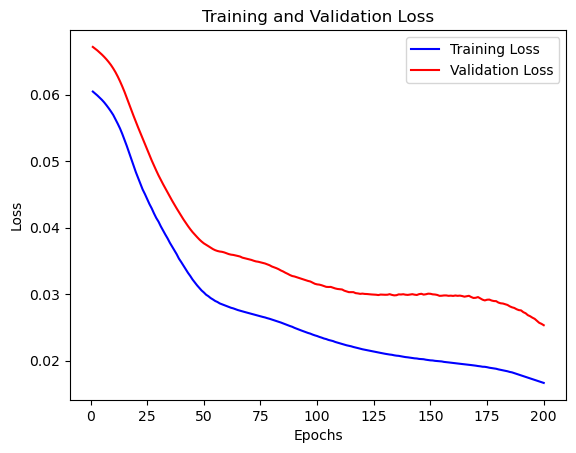

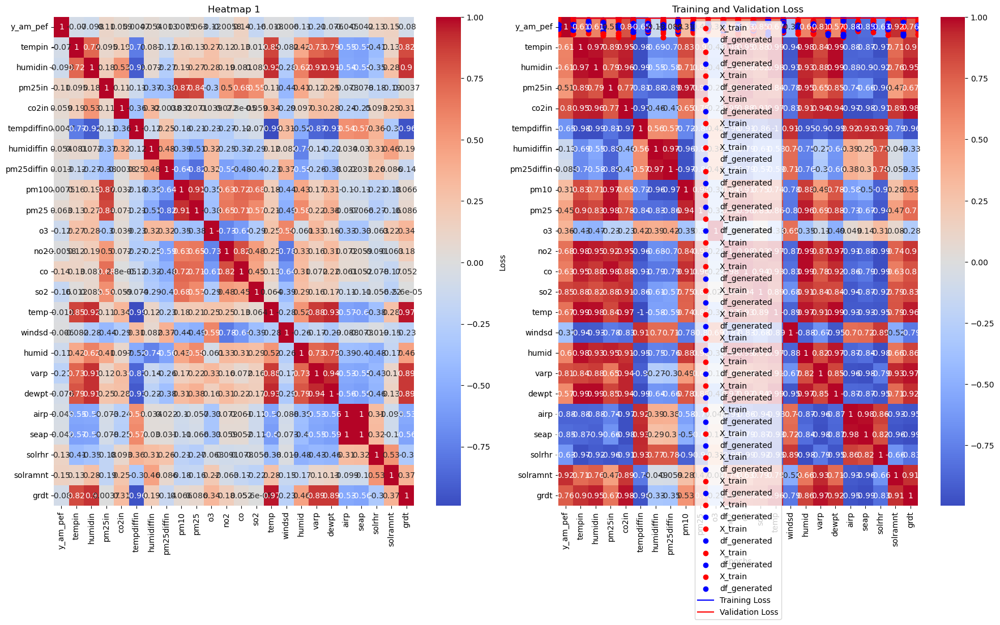

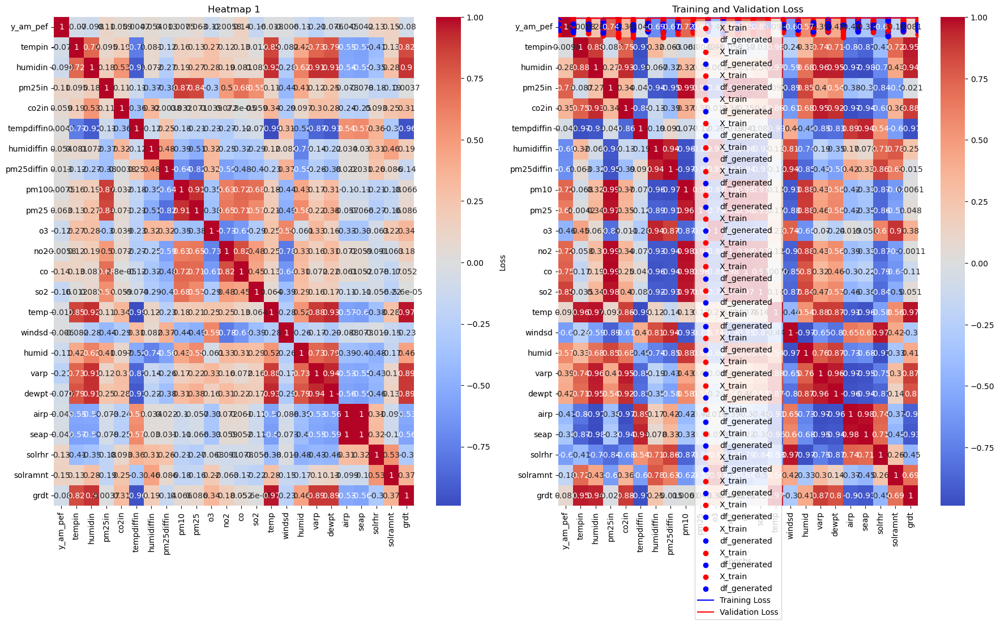

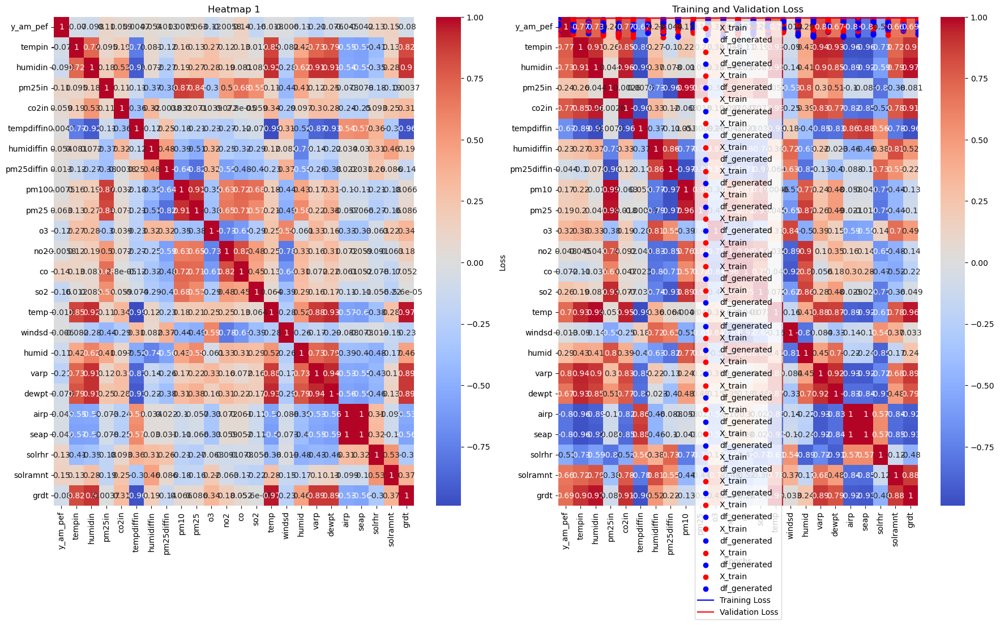

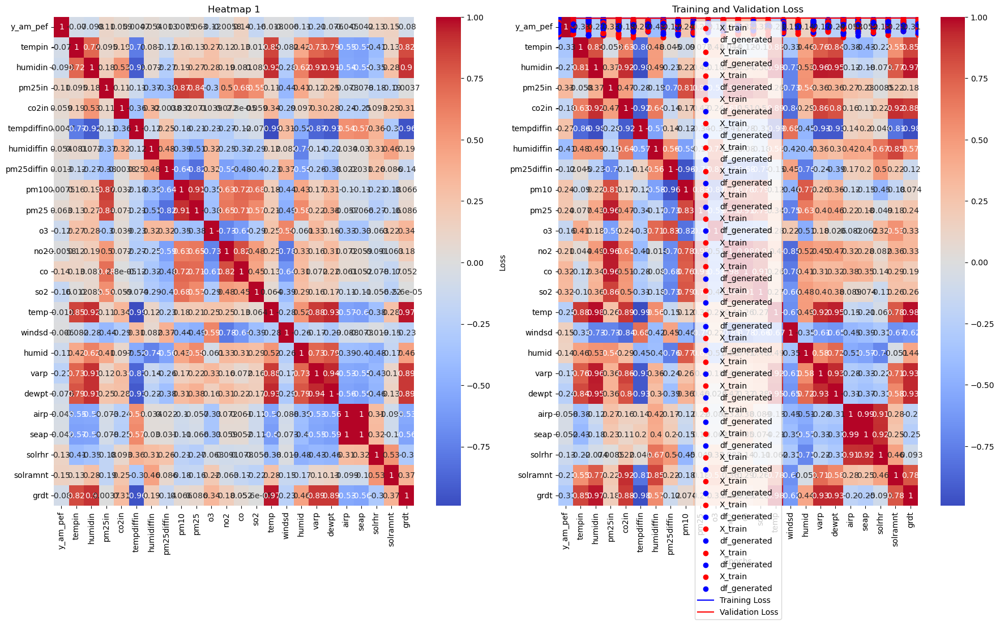

...

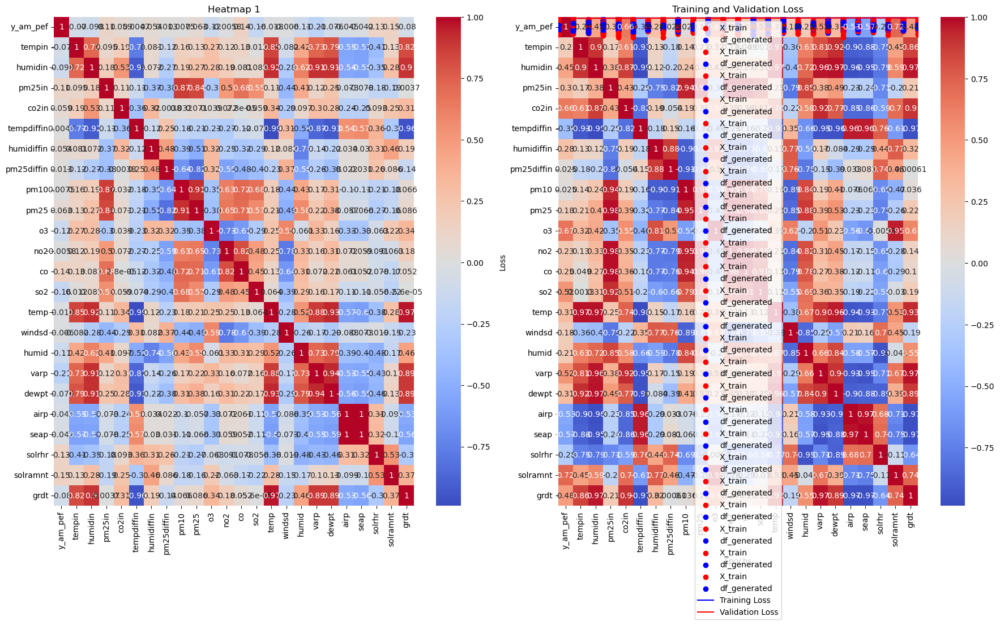

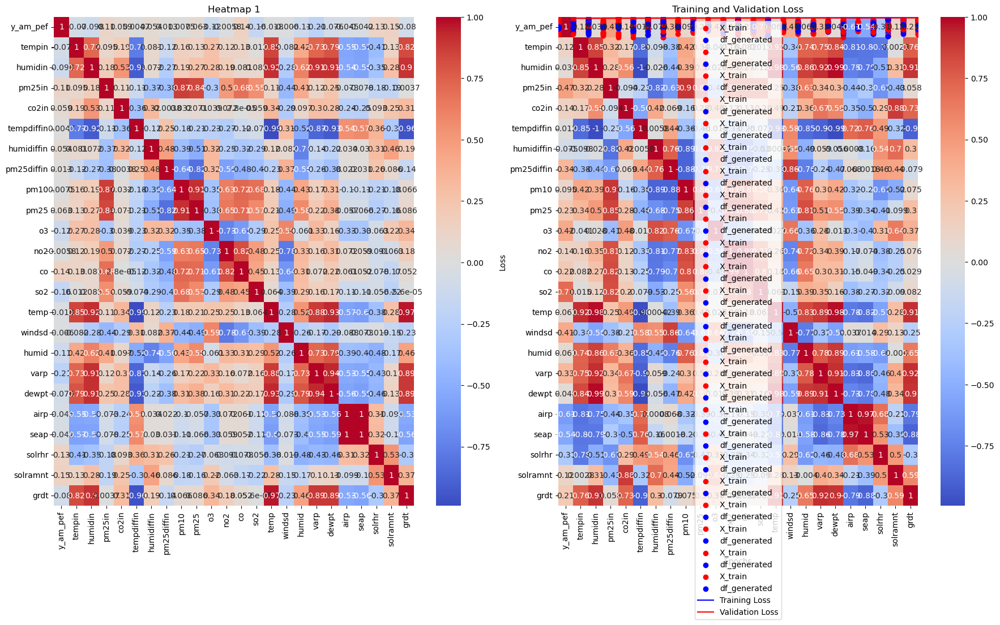

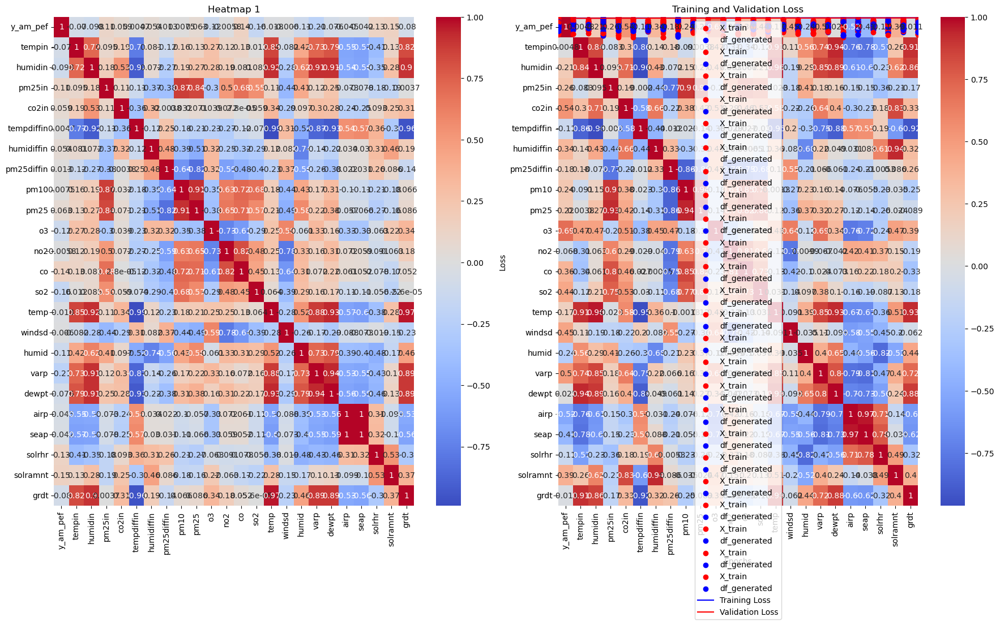

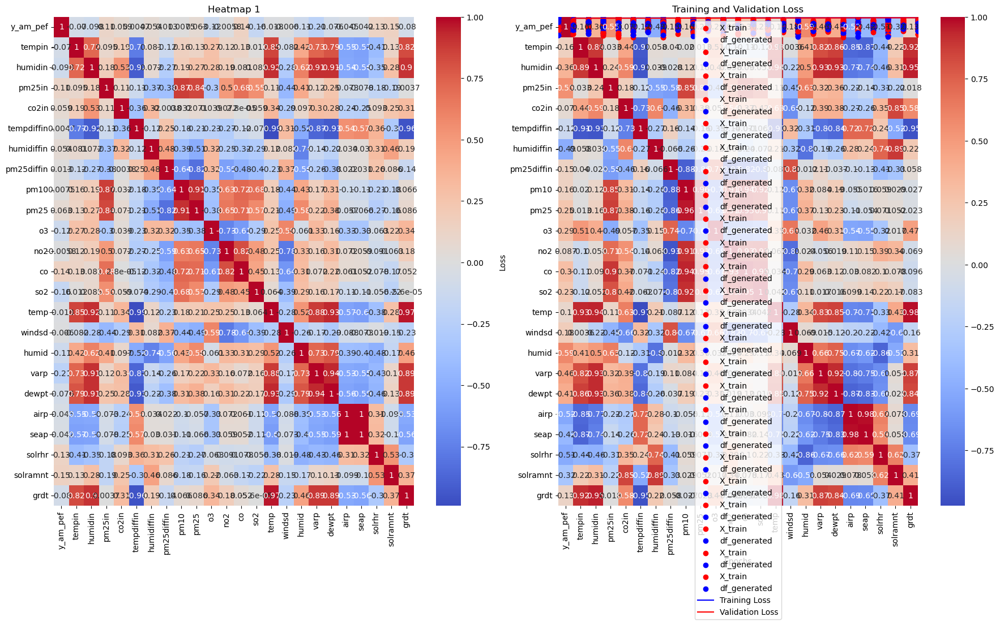

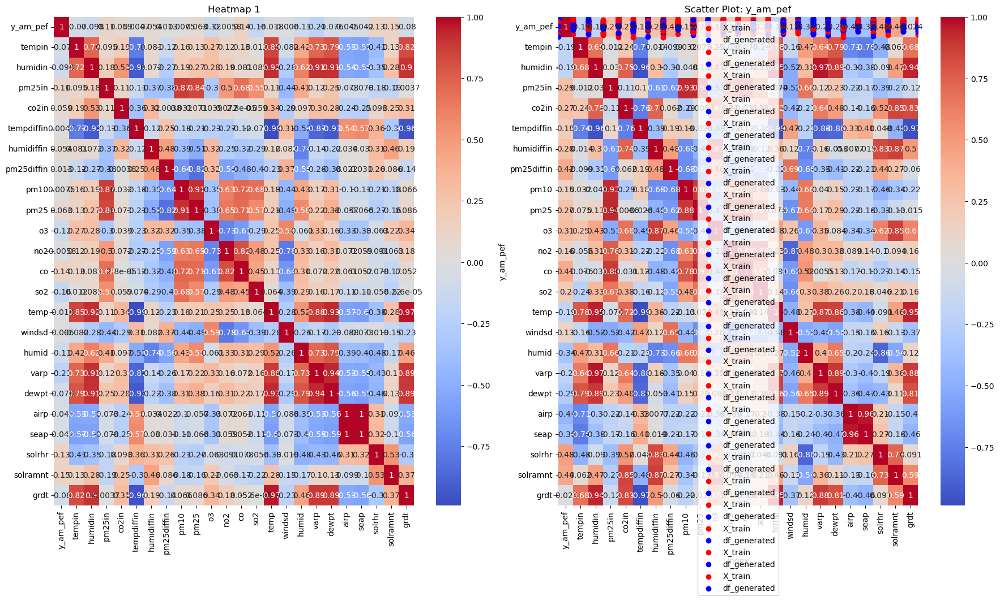

In [11]:
start_time = time.time()

for bn in bottle_neck_trial:
  for enc_layers in encoder_dense_layers_trial:
      for dec_layers in decoder_dense_layers_trial:
          print(enc_layers, bn, dec_layers)
          runner(enc_layers, bn, dec_layers)
                
end_time = time.time()
total_time = end_time - start_time                
total_time_minutes = total_time / 60
print(f"Total time: {total_time_minutes} minutes") 

In [12]:
print(run_summary)

[['L24_E10_8_B14_D8_10', 0.016634460538625717, 0.025318654254078865], ['L24_E10_8_B14_D10_12', 0.012433125637471676, 0.02020098827779293], ['L24_E10_8_B14_D12_14', 0.011332768015563488, 0.018543165177106857], ['L24_E10_8_B14_D14_16', 0.00874600000679493, 0.015377605333924294], ['L24_E10_8_B14_D16_18', 0.010634057223796844, 0.01846289075911045], ['L24_E10_8_B14_D18_20', 0.009528780356049538, 0.014417068101465702], ['L24_E10_8_B14_D20_22', 0.011492094956338406, 0.02047443576157093], ['L24_E12_10_B14_D8_10', 0.014938395470380783, 0.024738460779190063], ['L24_E12_10_B14_D10_12', 0.012164013460278511, 0.017890533432364464], ['L24_E12_10_B14_D12_14', 0.011970018967986107, 0.017954476177692413], ['L24_E12_10_B14_D14_16', 0.009808813221752644, 0.017162851989269257], ['L24_E12_10_B14_D16_18', 0.010080093517899513, 0.016826998442411423], ['L24_E12_10_B14_D18_20', 0.00745228910818696, 0.014155453070998192], ['L24_E12_10_B14_D20_22', 0.012036891654133797, 0.017635632306337357], ['L24_E14_12_B14_D8

In [13]:
import csv
#save run_summary as a file
filename = 'run_summary.csv'

with open(filename, 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(run_summary)

print(f"Run summary has saved: {filename}")

Run summary has saved: run_summary.csv


In [14]:
run_summary.sort(key=lambda x: x[1], reverse=True)  # Sort by the middle value in descending order

top_10 = run_summary[:10]  # Get the top 10 elements

for item in top_10:
    print(item)

['L24_E14_12_B14_D16_18', 0.016678690910339355, 0.026410629972815514]
['L24_E10_8_B14_D8_10', 0.016634460538625717, 0.025318654254078865]
['L24_E12_10_B14_D8_10', 0.014938395470380783, 0.024738460779190063]
['L24_E22_20_B14_D8_10', 0.012641334906220436, 0.02022997848689556]
['L24_E18_16_B14_D8_10', 0.01258454192429781, 0.019625643268227577]
['L24_E10_8_B14_D10_12', 0.012433125637471676, 0.02020098827779293]
['L24_E18_16_B14_D12_14', 0.012321696616709232, 0.02013140544295311]
['L24_E16_14_B14_D12_14', 0.012275640852749348, 0.019249336794018745]
['L24_E12_10_B14_D10_12', 0.012164013460278511, 0.017890533432364464]
['L24_E12_10_B14_D20_22', 0.012036891654133797, 0.017635632306337357]


In [15]:
for item in run_summary:
    print(item)

['L24_E14_12_B14_D16_18', 0.016678690910339355, 0.026410629972815514]
['L24_E10_8_B14_D8_10', 0.016634460538625717, 0.025318654254078865]
['L24_E12_10_B14_D8_10', 0.014938395470380783, 0.024738460779190063]
['L24_E22_20_B14_D8_10', 0.012641334906220436, 0.02022997848689556]
['L24_E18_16_B14_D8_10', 0.01258454192429781, 0.019625643268227577]
['L24_E10_8_B14_D10_12', 0.012433125637471676, 0.02020098827779293]
['L24_E18_16_B14_D12_14', 0.012321696616709232, 0.02013140544295311]
['L24_E16_14_B14_D12_14', 0.012275640852749348, 0.019249336794018745]
['L24_E12_10_B14_D10_12', 0.012164013460278511, 0.017890533432364464]
['L24_E12_10_B14_D20_22', 0.012036891654133797, 0.017635632306337357]
['L24_E12_10_B14_D12_14', 0.011970018967986107, 0.017954476177692413]
['L24_E14_12_B14_D10_12', 0.011954973451793194, 0.018746813759207726]
['L24_E22_20_B14_D10_12', 0.011766159906983376, 0.018031228333711624]
['L24_E18_16_B14_D16_18', 0.011566822417080402, 0.01698165014386177]
['L24_E20_18_B14_D14_16', 0.011